## Project Proposal Title: Music classification

Problem Statement:
- Can a song be accurately classified into 10 different genres solely based on its audio file using machine learning techniques?


|SUMMARY|
|:------------------------------------------------|
|[**1. Data Analysis**](#DataAnalysis)|
|[**2. Load Data**](#LoadData)|
|[**3. Baseline Model**](#BaselineModel)|
|[**4. Models**](#Models)|
|[4.1. Model 1](#Model1)|
|[4.2. Model 2](#Model2)|
|[4.3. Model 3](#Model3)|
|[4.4. Model 4](#Model4)|
|[4.5. Model 5](#Model5)|
|[**5. Transfer Learning**](#TransferLearning)|
|[5.1. Resnet50](#Resnet50)|
|[5.2. EfficientNetB2](#EfficientNetB2)|
|[5.3. Model Performance](#ModelPerformanceTranferLearning)|
|[**6. Conclusion**](#Conclusion)|

This project has as main goal to answer if it is possible to classify a song in 10 different genres using only information from an audio file and machine learning techniques. \
There are several possible use cases for this project. The most direct use cases are to classify folders, and to classify new songs in streaming services. Moreover, once a song is classified in a genre, this can be used as an input in a recommendation model. What is more, if the model developed in this project successfully classify the songs, it will be possible to use it as a base model in a transfer learning technique to solve any classification problem related to audio, i.e., if the audio from a heart beat indicates any disease.  

The data: \
He data used in this Project was is the GTZAN Dataset. This data is available in https://opihi.cs.uvic.ca/sound/genres.tar.gz and https://www.kaggle.com/datasets/andradaolteanu/gtzan-dataset-music-genre-classification. In Kaggle, besides the audio files in WAV format, there is also the MEL spectrogram of each song and an csv file with some features. However, this project relies only in the audio files. \
Each audio file has 30 seconds and they are classified in 10 different music genres: blues, classical, country, disco, hiphop, jazz, metal, pop, reggae, rock. There are 100 samples for each genre but for jazz that has only 99 samples.



In [1]:
# pip install librosa
# ! pip install tqdm
# ! pip install pydot

In [2]:
import os
import gc
import time
import tqdm    # pip install tqdm
import IPython.display as ipd

import librosa   # pip install librosa
import librosa.display

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score

import tensorflow as tf
from tensorflow import keras

In [3]:
print(f"tensorflow version {tf.__version__}")
print(f"Eager Execution Enabled: {tf.executing_eagerly()}\n")

devices = tf.config.get_visible_devices()
print(f"All Devices: \n{devices}\n")
print(f"Available GPUs: \n{tf.config.list_logical_devices('GPU')}\n")

AUTOTUNE = tf.data.AUTOTUNE

tf.random.set_seed(1)

tensorflow version 2.10.1
Eager Execution Enabled: True

All Devices: 
[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

Available GPUs: 
[LogicalDevice(name='/device:GPU:0', device_type='GPU')]



In [4]:
flag_MEL_data = 1 # If you already have a data set with the MEL frequency
flag_freq_data = 1 # If you already have a data set with the raw frequency

<div id='DataAnalysis' />

## Data Analysis

I will verify the audio waveform signal and the MEL spectrogram of one song for each genre. \
Leland Roberts in https://medium.com/analytics-vidhya/understanding-the-mel-spectrogram-fca2afa2ce53 describes a spectrogram as a way to visually represent a signal’s loudness, or amplitude, as it varies over time at different frequencies. He adds that the MEL transformation is a unit of pitch such that equal distances in pitch sounds equally distant to the listener..



In [5]:
# Verify genres
music_path = "Data/genres_original/"
music_genres = os.listdir(f'{music_path}')
print(f'Music genres: {music_genres}')

# I will remove some music genres because of lack of memory.
# music_genres.remove('disco')
# music_genres.remove('country')
# music_genres.remove('blues')
# music_genres.remove('hiphop')
# music_genres.remove('reggae')

# File music example
for e in music_genres:
    print()
    print(f'Playing : {e}.00099.wav')
    display(ipd.Audio(f'{music_path}{e}/{e}.00099.wav'))

Music genres: ['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock']

Playing : blues.00099.wav



Playing : classical.00099.wav



Playing : country.00099.wav



Playing : disco.00099.wav



Playing : hiphop.00099.wav



Playing : jazz.00099.wav



Playing : metal.00099.wav



Playing : pop.00099.wav



Playing : reggae.00099.wav



Playing : rock.00099.wav


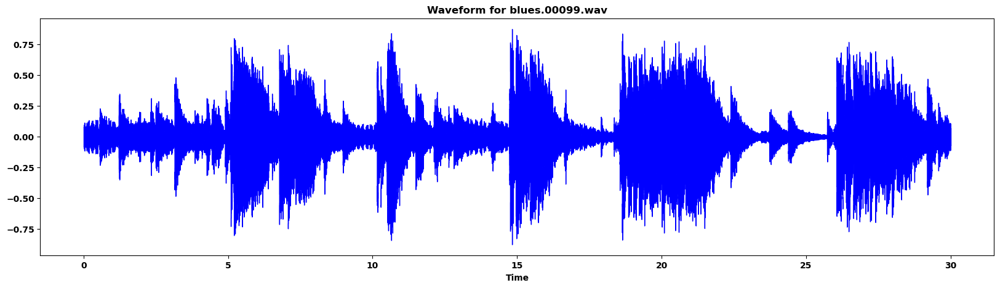

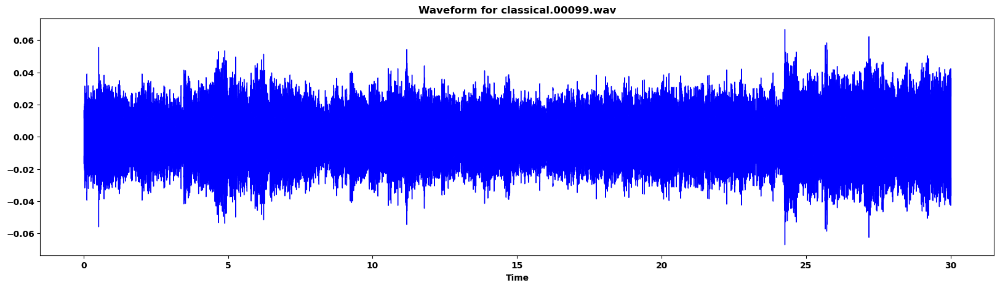

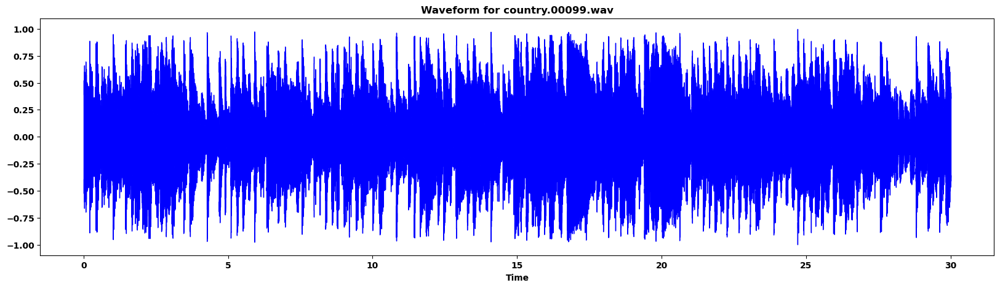

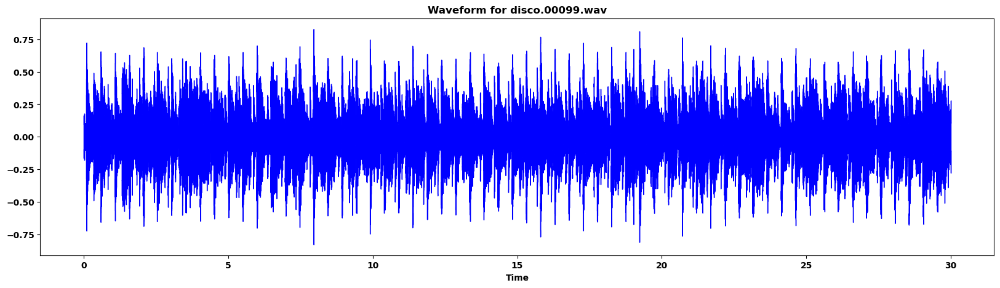

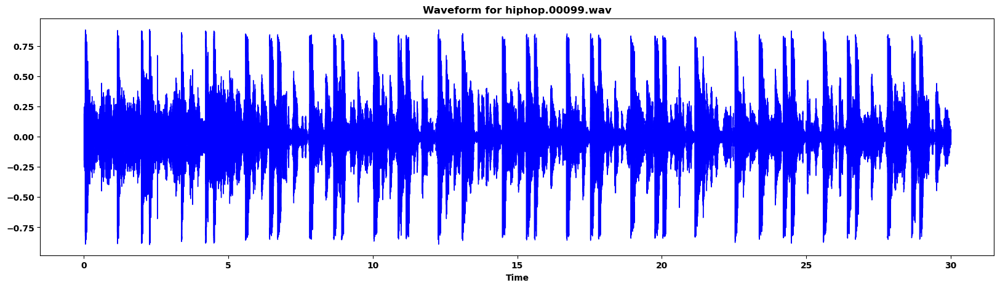

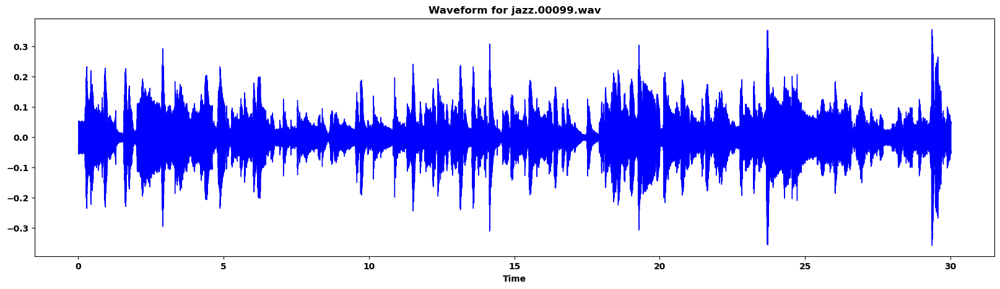

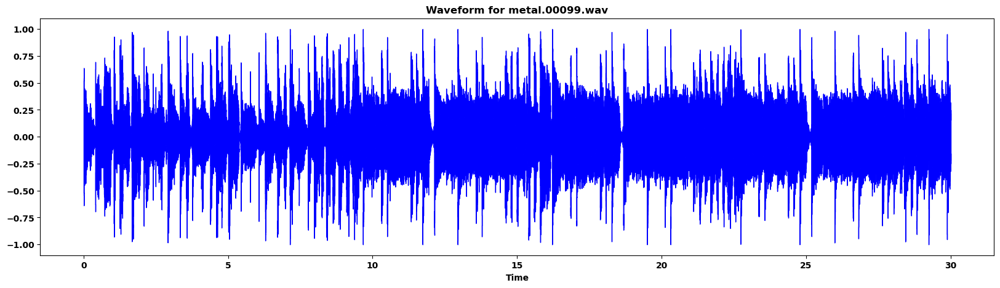

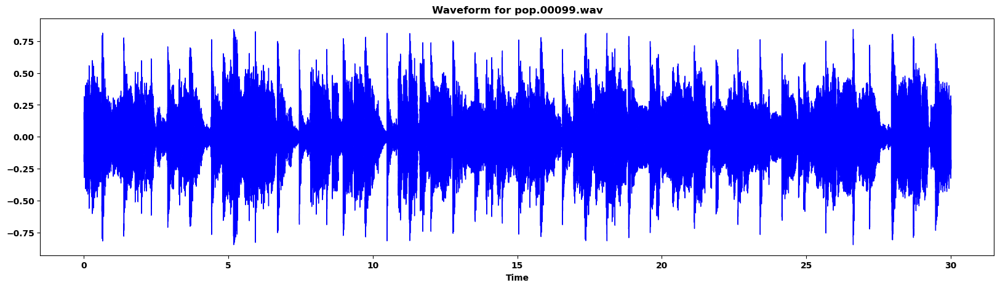

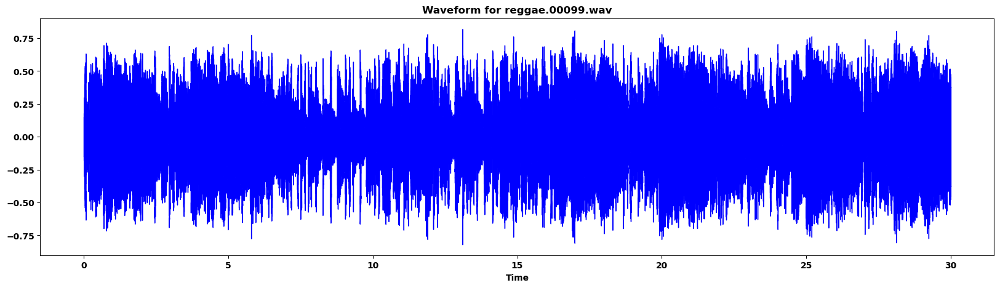

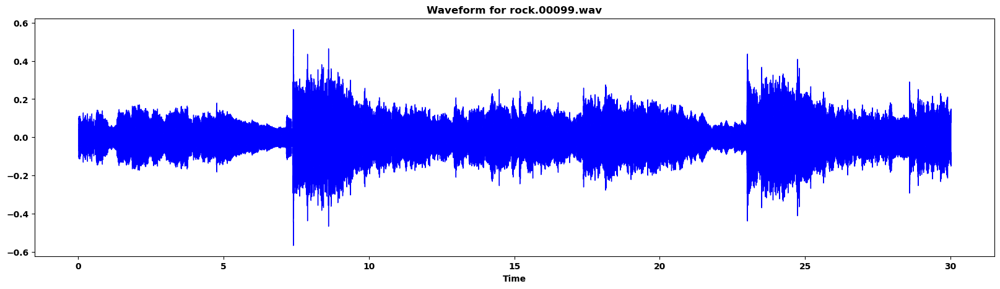

In [6]:
# Waveform
for e in music_genres:
    sound, sample_rate = librosa.load(f'{music_path}{e}/{e}.00099.wav')
    plt.figure(figsize = (20, 5))
    librosa.display.waveshow(y = sound, sr = sample_rate, color = "blue")
    plt.title(f"Waveform for {e}.00099.wav", fontsize = 12)  
    plt.show()
    

However, if we were to transform these frequencies into features, we would end up with more than 650,000 variables! \
Another way of representing a song is by the MFCC (Mel-frequency Cepstral coefficient).

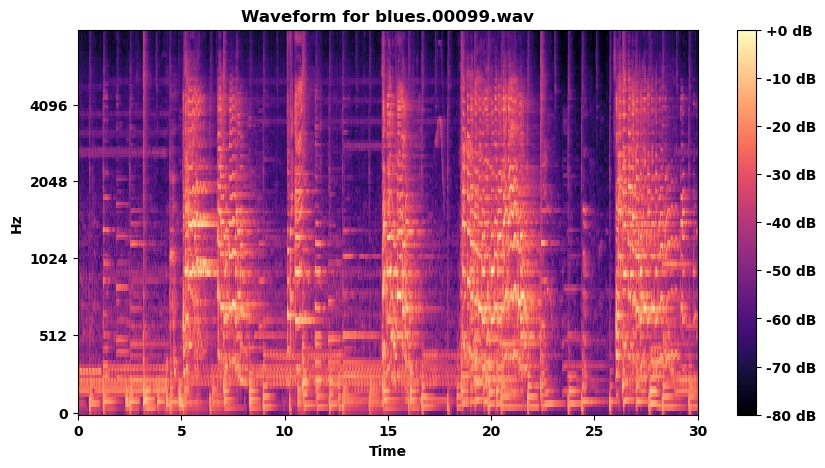

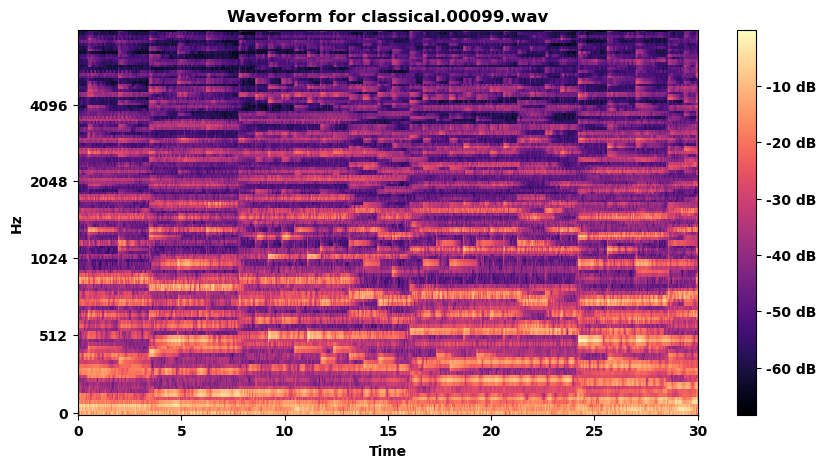

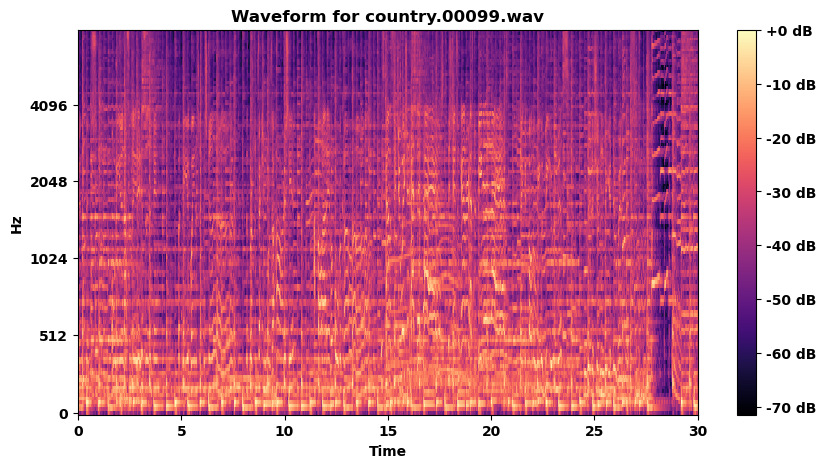

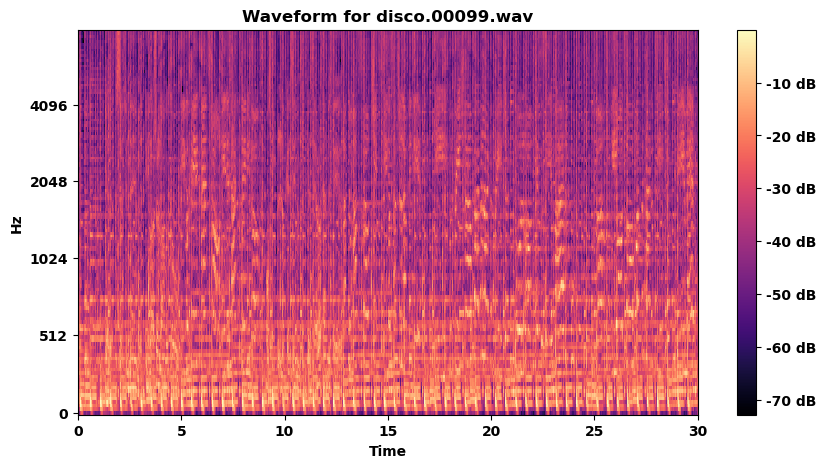

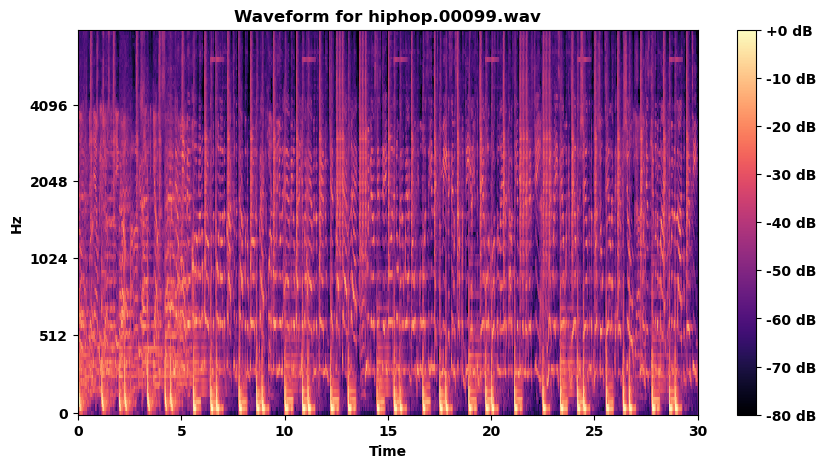

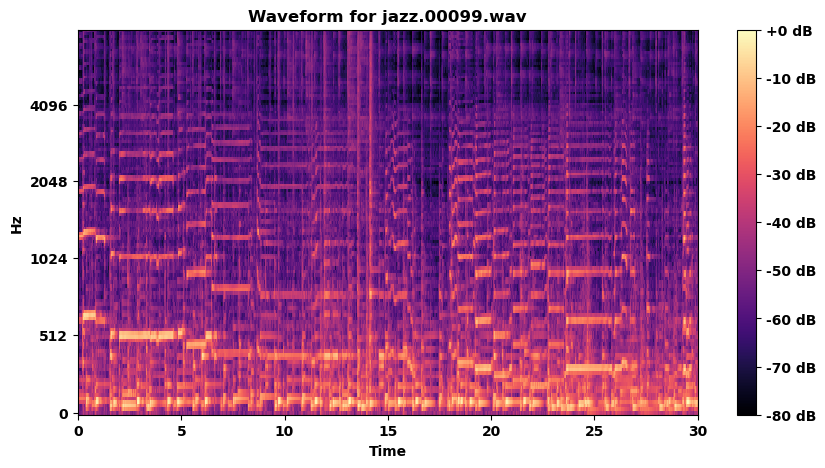

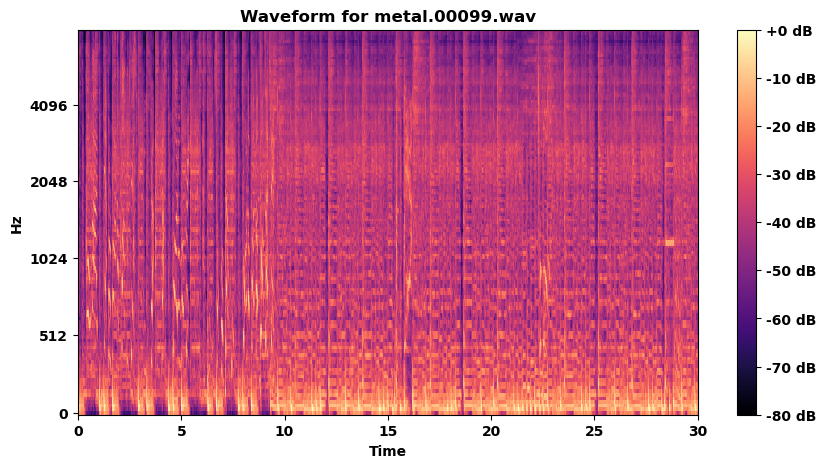

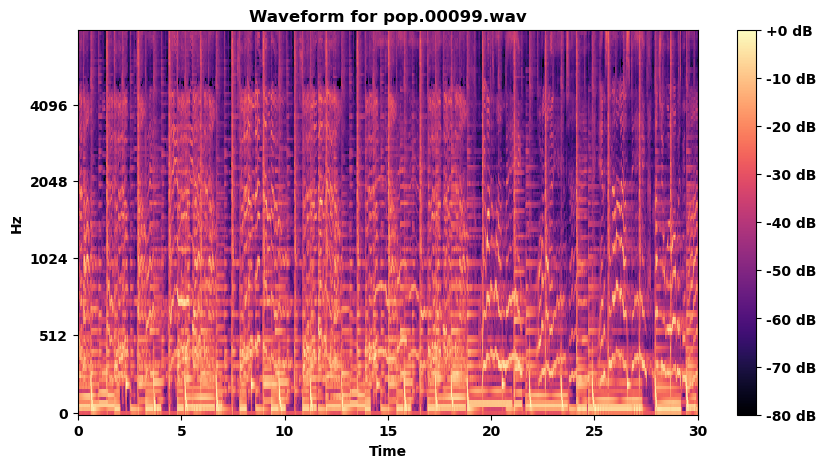

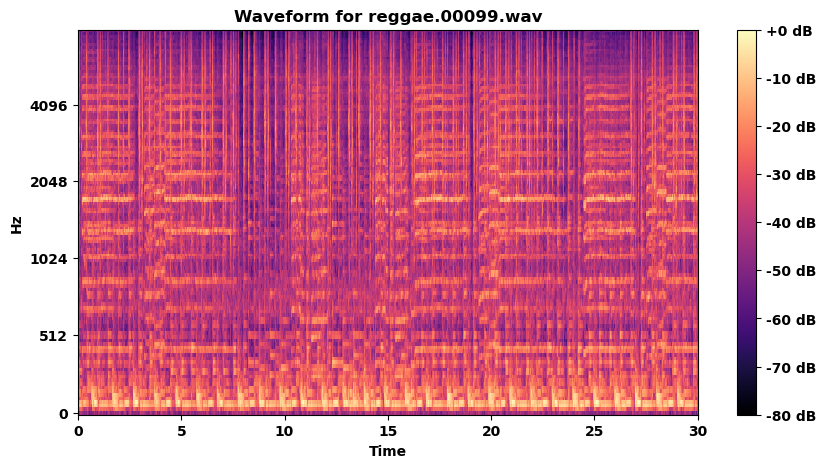

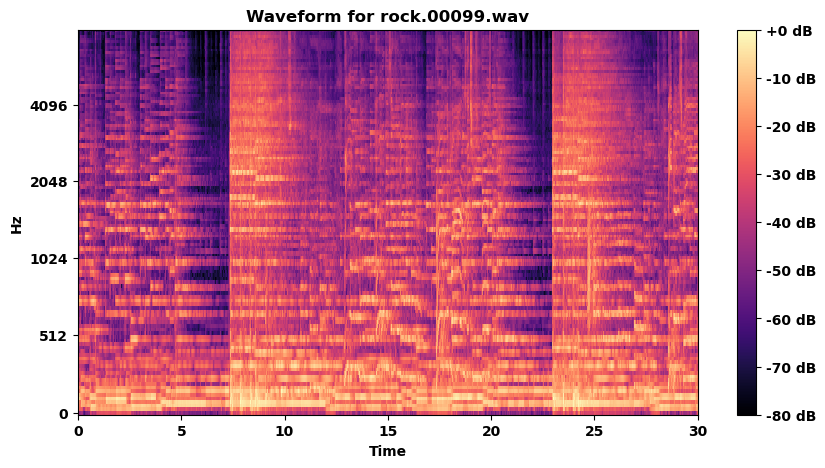

In [7]:
# MEL
for e in music_genres:
    sound, sample_rate = librosa.load(f'{music_path}{e}/{e}.00099.wav')
    # From: https://librosa.org/doc/main/generated/librosa.feature.melspectrogram.html
    S = librosa.feature.melspectrogram(y = sound, sr = sample_rate, n_mels = 128, fmax = 8000)
    fig, ax = plt.subplots(figsize = (10, 5))
    S_dB = librosa.power_to_db(S, ref = np.max)
    img = librosa.display.specshow(S_dB, x_axis = 'time',
                             y_axis = 'mel', sr = sample_rate,
                             fmax = 8000, ax = ax)
    fig.colorbar(img, ax = ax, format = '%+2.0f dB')
    ax.set(title = f"Waveform for {e}.00099.wav");
    plt.show()

We can use these MEL pictures to run try a CNN model.

## Save MEL pictures

In [8]:
if flag_MEL_data != 1:
    for e in music_genres:
        for i in tqdm.tqdm(range(0, 100)):
            if i < 10:
                sound, sample_rate = librosa.load(f'{music_path}{e}/{e}.0000{i}.wav')
                S = librosa.feature.melspectrogram(y = sound, sr = sample_rate, n_mels = 128, fmax = 8000)
                fig, ax = plt.subplots(figsize = (10, 5))
                S_dB = librosa.power_to_db(S, ref = np.max)
                img = librosa.display.specshow(S_dB, x_axis = 'time',
                                         y_axis = 'mel', sr = sample_rate,
                                         fmax = 8000, ax = ax)
    
                plt.tight_layout()
                plt.savefig(f"Data/train_images/{e}/{e}.0000{i}.png")
                plt.close()
            else:
                if (e != 'jazz') | (i != 54):    # There is a problem with this music file
                    sound, sample_rate = librosa.load(f'{music_path}{e}/{e}.000{i}.wav')
                    S = librosa.feature.melspectrogram(y = sound, sr = sample_rate, n_mels = 128, fmax = 8000)
                    fig, ax = plt.subplots(figsize = (10, 5))
                    S_dB = librosa.power_to_db(S, ref = np.max)
                    img = librosa.display.specshow(S_dB, x_axis = 'time',
                                             y_axis = 'mel', sr = sample_rate,
                                             fmax = 8000, ax = ax)
                    if i < 65:
                        plt.tight_layout()
                        plt.savefig(f"Data/train_images/{e}/{e}.000{i}.png")
                        plt.close()
                    elif i < 80:
                        plt.tight_layout()
                        plt.savefig(f"Data/val_images/{e}/{e}.000{i}.png")
                        plt.close()
                    else:
                        plt.tight_layout()
                        plt.savefig(f"Data/test_images/{e}/{e}.000{i}.png")
                        plt.close()

<div id='LoadData' />

## Load Data.

For all the models was used 649 songs for the training set, 150 for the validation set, and 200 for the test set.  

In [9]:
batch_size = 16
img_height = 150 # Original size: 288
img_width = 150 # Original size: 432
train_images_path = "Data/train_images/"
val_images_path = "Data/val_images/"
test_images_path = "Data/test_images/"

ds_train = tf.keras.utils.image_dataset_from_directory(
                                                          train_images_path,
                                                          # validation_split = 0.2,
                                                          # subset = "training",
                                                          seed = 1 ,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = False
                                                        )

ds_val = tf.keras.utils.image_dataset_from_directory(
                                                          val_images_path,
                                                          # validation_split = 0.2,
                                                          # subset = "validation",
                                                          seed = 1 ,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = False
                                                        )

# Shuffle data
ds_train_shuffled = ds_train.unbatch().shuffle(buffer_size = 649, seed = 1)
ds_train_shuffled = ds_train_shuffled.batch(batch_size)
ds_val_shuffled = ds_val.unbatch().shuffle(buffer_size = 150, seed = 1)
ds_val_shuffled = ds_val_shuffled.batch(batch_size)

ds_test = tf.keras.utils.image_dataset_from_directory(
                                                          test_images_path,
                                                          seed = 1 ,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = False
                                                        )

# Extract class names
class_names = ds_test.class_names

Found 649 files belonging to 10 classes.
Found 150 files belonging to 10 classes.
Found 200 files belonging to 10 classes.


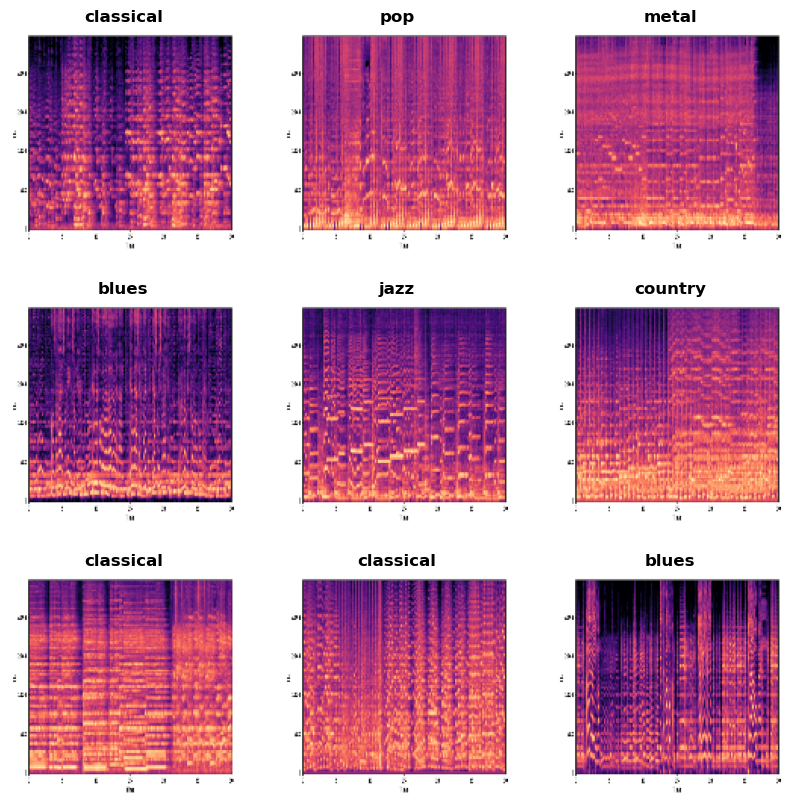

In [10]:
plt.figure(figsize=(10, 10))
for images, labels in ds_train_shuffled.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

## Normalize data

In [11]:
# Normalize data
normalization_layer = keras.layers.Rescaling(1./255)

# Necessary for model 3
ds_train_shuffled = ds_train_shuffled.map(lambda x, y: (normalization_layer(x), y))
ds_val_shuffled = ds_val_shuffled.map(lambda x, y: (normalization_layer(x), y))
ds_test = ds_test.map(lambda x, y: (normalization_layer(x), y))

# Normalized dataset
for images, labels in ds_train_shuffled.take(1):
    print(images[0].numpy().min(), images[0].numpy().max())
    print(labels[0].numpy(), class_names[labels[0].numpy()])

0.0 1.0
3 disco


In [12]:
# check the dataset
print('Train')
for x, y in ds_train_shuffled.take(1):
    print("x_test shape:", x.shape)
    print("y_test shape:", y.shape)
print('---------------------------')
print('Validation')
for x, y in ds_val_shuffled.take(1):
    print("x_val shape:", x.shape)
    print("y_val shape:", y.shape) 
print('---------------------------')
print('Test')
for x, y in ds_test.take(1):
    print("x_train shape:", x.shape)
    print("y_train shape:", y.shape) 

Train
x_test shape: (16, 150, 150, 3)
y_test shape: (16,)
---------------------------
Validation
x_val shape: (16, 150, 150, 3)
y_val shape: (16,)
---------------------------
Test
x_train shape: (16, 150, 150, 3)
y_train shape: (16,)


In [13]:
# Plot the training and validation history
def plot_train_val_metric(model_history, metric, ylabel):
    fig, axes = plt.subplots(1, 1, figsize=(10,5))

    axes.plot(model_history.history[metric], label='Training')
    axes.plot(model_history.history['val_' + metric], label='Validation')
    best_metric = np.nanmax(model_history.history['val_' + metric])
    epoch_best_metric = np.nanargmax(model_history.history['val_' + metric]) + 1
    axes.axvline(np.nanargmax(model_history.history['val_' + metric]),
                    c='k', ls='--',
                    label=f'best val {metric} = {best_metric:.6f}, epoch = {epoch_best_metric}')


    axes.set_xlabel('Epoch')
    axes.set_ylabel(ylabel)
    axes.set_title(f"Training and Validation {metric}")
    axes.legend()
    
    plt.show()
    plt.close();
    
    return epoch_best_metric, best_metric

<div id='BaselineModel' />

## Baseline Model

In [14]:
# Baseline model
tf.keras.backend.clear_session()
gc.collect()
def create_Baseline_model(img_height, img_width, y_nunique):
    tf.keras.backend.clear_session()
    tf.keras.backend.clear_session()
    inputs = tf.keras.layers.Input(shape = (img_height, img_width, 3))
    x = keras.layers.Conv2D(filters = 64, kernel_size = (3, 3), strides = (1, 1), padding = 'same'   
                               , activation='relu', name = "Conv2D_1")(inputs)
    x = keras.layers.MaxPooling2D(pool_size = 3, strides = 1)(x)
    
    x = keras.layers.Flatten()(x)
    x = keras.layers.Dense(128, activation = 'selu', name = "SeLU_1")(x)
    
    outputs = keras.layers.Dense(units = y_nunique, activation = 'softmax', name = 'output')(x)
    
    model = keras.models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = 'sparse_categorical_crossentropy',
                  optimizer = keras.optimizers.Adam(learning_rate = 0.00001),
                  metrics = ['acc'],
                 )

    return model

baseline_model = create_Baseline_model(img_height, img_width, y_nunique = len(class_names))
baseline_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 Conv2D_1 (Conv2D)           (None, 150, 150, 64)      1792      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 148, 148, 64)     0         
 )                                                               
                                                                 
 flatten (Flatten)           (None, 1401856)           0         
                                                                 
 SeLU_1 (Dense)              (None, 128)               179437696 
                                                                 
 output (Dense)              (None, 10)                1290      
                                                             

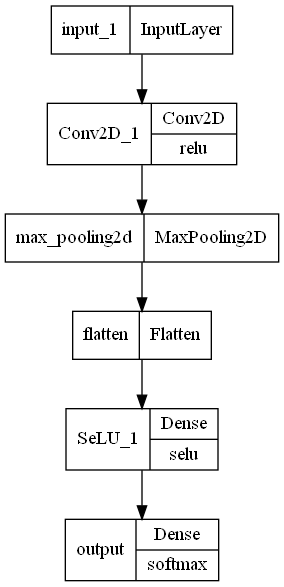

In [15]:
keras.utils.plot_model(baseline_model, show_layer_activations=True)  # pip install pydot; sudo apt install graphviz

In [16]:
# Train model
start = time.time()
epochs = 200
baseline_model_history = baseline_model.fit(ds_train_shuffled
                                        , validation_data = ds_val_shuffled
                                        # , batch_size = 32
                                        , epochs = epochs
                                        , verbose = 1
                                        , workers = -1
                                        , use_multiprocessing = True)
end = time.time()
end_time = (end - start)
print(f'Run time in minutes: {end_time/60:.2f}')

Epoch 1/200
41/41 [==============================] - 7s 71ms/step - loss: 3.5545 - acc: 0.1248 - val_loss: 2.3219 - val_acc: 0.1000
Epoch 2/200
41/41 [==============================] - 3s 62ms/step - loss: 2.2210 - acc: 0.1757 - val_loss: 2.1566 - val_acc: 0.2800
Epoch 3/200
41/41 [==============================] - 3s 62ms/step - loss: 2.0199 - acc: 0.2758 - val_loss: 2.0374 - val_acc: 0.2400
Epoch 4/200
41/41 [==============================] - 3s 62ms/step - loss: 1.9424 - acc: 0.3128 - val_loss: 1.9612 - val_acc: 0.3267
Epoch 5/200
41/41 [==============================] - 3s 62ms/step - loss: 1.7499 - acc: 0.4022 - val_loss: 1.9430 - val_acc: 0.3400
Epoch 6/200
41/41 [==============================] - 3s 62ms/step - loss: 1.5990 - acc: 0.4453 - val_loss: 1.9185 - val_acc: 0.3333
Epoch 7/200
41/41 [==============================] - 3s 62ms/step - loss: 1.6868 - acc: 0.4391 - val_loss: 2.0697 - val_acc: 0.2933
Epoch 8/200
41/41 [==============================] - 3s 62ms/step - loss: 1.

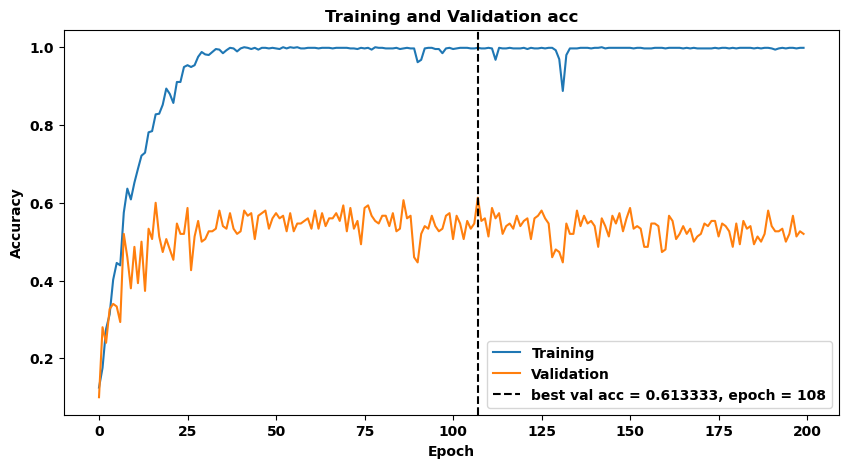

In [17]:
best_epoch, best_mse = plot_train_val_metric(baseline_model_history, 'acc', ylabel = 'Accuracy')

<div id='Models' />

## Models

Let's try to solve the overfitting problem.

<div id='Model1' />
    
## Model 1

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 Conv2D_1 (Conv2D)           (None, 150, 150, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 148, 148, 16)     0         
 )                                                               
                                                                 
 flatten (Flatten)           (None, 350464)            0         
                                                                 
 SeLU_1 (Dense)              (None, 128)               44859520  
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                             

None

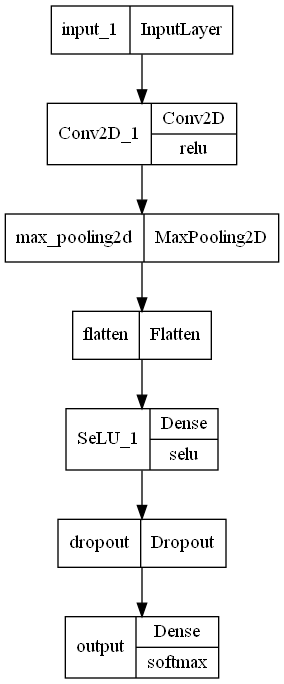

In [18]:
# model 1
tf.keras.backend.clear_session()
gc.collect()
def create_model_1(img_height, img_width, y_nunique):
    tf.keras.backend.clear_session()
    tf.keras.backend.clear_session()
    inputs = tf.keras.layers.Input(shape = (img_height, img_width, 3))
    x = keras.layers.Conv2D(filters = 16, kernel_size = (3, 3), strides = (1, 1), padding = 'same'     # 64 = 0.6133; 32 = 0.6000; 16 = 0.6066 ; 8 = 0.57336
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      # 0.01 = 0.620; 0.05 = 0.6133
                               , bias_regularizer = keras.regularizers.l2(0.01)                        # 0.01 = 0.63333; 0.05 = 0.6133
                               , name = "Conv2D_1")(inputs)    
    x = keras.layers.MaxPooling2D(pool_size = 3, strides = 1)(x)
    
    x = keras.layers.Flatten()(x)
    x = keras.layers.Dense(128, activation = 'selu', name = "SeLU_1")(x)
    x = keras.layers.Dropout(0.10)(x)   # 0.00 = 0.62667; 0.10 = 0.626; 0.25 = 0.5933   Just using dropout layer does not help with the overfit
    
    outputs = keras.layers.Dense(units = y_nunique, activation = 'softmax', name = 'output')(x)
    
    model = keras.models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = 'sparse_categorical_crossentropy',
                  optimizer = keras.optimizers.Adam(learning_rate = 0.00001),
                  metrics = ['acc'],
                 )

    return model

model_1 = create_model_1(img_height, img_width, y_nunique = len(class_names))
display(model_1.summary())
print()
display(keras.utils.plot_model(model_1, show_layer_activations=True))

In [19]:
# Train model 
start = time.time()
epochs = 100
model_1_history = model_1.fit(ds_train_shuffled
                                , validation_data = ds_val_shuffled
                                # , batch_size = 32
                                , epochs = epochs
                                , verbose = 1
                                , workers = -1
                                , use_multiprocessing = True)
end = time.time()
end_time = (end - start)
print(f'Run time in minutes: {end_time/60:.2f}')

Epoch 1/100
41/41 [==============================] - 3s 34ms/step - loss: 3.0291 - acc: 0.1171 - val_loss: 2.2623 - val_acc: 0.1600
Epoch 2/100
41/41 [==============================] - 2s 30ms/step - loss: 2.3316 - acc: 0.2311 - val_loss: 2.2591 - val_acc: 0.2867
Epoch 3/100
41/41 [==============================] - 2s 28ms/step - loss: 2.0271 - acc: 0.3035 - val_loss: 2.4425 - val_acc: 0.3000
Epoch 4/100
41/41 [==============================] - 2s 29ms/step - loss: 1.9608 - acc: 0.3513 - val_loss: 1.9513 - val_acc: 0.3400
Epoch 5/100
41/41 [==============================] - 2s 28ms/step - loss: 1.7723 - acc: 0.3960 - val_loss: 1.7873 - val_acc: 0.3533
Epoch 6/100
41/41 [==============================] - 2s 28ms/step - loss: 1.5611 - acc: 0.4715 - val_loss: 1.8911 - val_acc: 0.3800
Epoch 7/100
41/41 [==============================] - 2s 28ms/step - loss: 1.4140 - acc: 0.5516 - val_loss: 1.7366 - val_acc: 0.3933
Epoch 8/100
41/41 [==============================] - 2s 28ms/step - loss: 1.

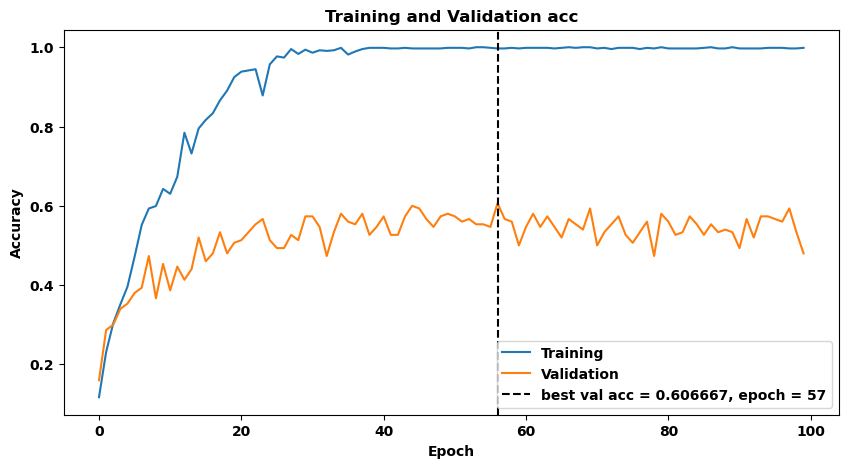

In [20]:
model_1_best_epoch, model_1_best_mse = plot_train_val_metric(model_1_history, 'acc', ylabel = 'Accuracy')

Adding a dropout layer, L2 kernel regularization, L2 bias regularization, and lowering the number of filters did not help in decreasing the overfit. \
Let's try a new architecture.

<div id='Model2' />

## Model 2

Only available in full code version.

<div id='Model3' />

## Model 3

Only available in full code version.

<div id='Model4' />

## model 4

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv2D_1 (Conv2D)              (None, 150, 150, 16  448         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 Conv2D_2 (Conv2D)              (None, 150, 150, 16  1216        ['input_1[0][0]']                
                                )                                                             

None

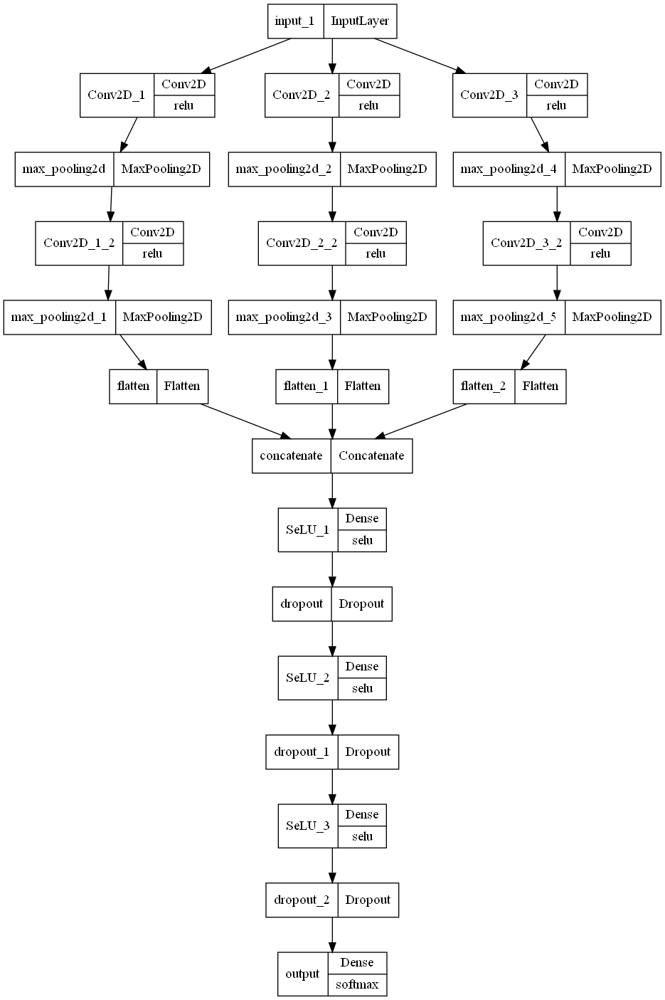

In [14]:
# model 4
tf.keras.backend.clear_session()
gc.collect()
def create_model_23(img_height, img_width, y_nunique):
    tf.keras.backend.clear_session()
    inputs = tf.keras.layers.Input(shape = (img_height, img_width, 3))
    x = keras.layers.Conv2D(filters = 16, kernel_size = (3, 3), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_1")(inputs)    
    x = keras.layers.MaxPooling2D(pool_size = 3, strides = 1)(x) 
    x = keras.layers.Conv2D(filters = 16, kernel_size = (3, 3), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_1_2")(x)    
    x = keras.layers.MaxPooling2D(pool_size = 3, strides = 1)(x)   
    x = keras.layers.Flatten()(x)

    x2 = keras.layers.Conv2D(filters = 16, kernel_size = (5, 5), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_2")(inputs)    
    x2 = keras.layers.MaxPooling2D(pool_size = 5, strides = 1)(x2) 
    x2 = keras.layers.Conv2D(filters = 16, kernel_size = (5, 5), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_2_2")(x2)    
    x2 = keras.layers.MaxPooling2D(pool_size = 5, strides = 1)(x2) 
    x2 = keras.layers.Flatten()(x2)

    
    x3 = keras.layers.Conv2D(filters = 16, kernel_size = (10, 10), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_3")(inputs)    
    x3 = keras.layers.MaxPooling2D(pool_size = 10, strides = 1)(x3) 
    x3 = keras.layers.Conv2D(filters = 16, kernel_size = (10, 10), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_3_2")(x3)    
    x3 = keras.layers.MaxPooling2D(pool_size = 10, strides = 1)(x3) 
    x3 = keras.layers.Flatten()(x3)
    
    concat_x_x2 = keras.layers.Concatenate()([x, x2, x3])
    
    x = keras.layers.Dense(128, activation = 'selu', name = "SeLU_1")(concat_x_x2)
    x = keras.layers.Dropout(0.10)(x)               
    x = keras.layers.Dense(32, activation='selu', name = "SeLU_2")(x)
    x = keras.layers.Dropout(0.10)(x)                
    x = keras.layers.Dense(16, activation='selu', name = "SeLU_3")(x)
    x = keras.layers.Dropout(0.10)(x)               
    outputs = keras.layers.Dense(units = y_nunique, activation = 'softmax', name = 'output')(x)
    
    model = keras.models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = 'sparse_categorical_crossentropy',
                  optimizer = keras.optimizers.Adam(learning_rate = 0.00001),
                  metrics = ['acc'],
                 )

    return model

model_23 = create_model_23(img_height, img_width, y_nunique = len(class_names))
display(model_23.summary())
print()
keras.utils.plot_model(model_23, show_layer_activations=True)

In [15]:
# Train model 
start = time.time()
epochs = 200

model_23_history = model_23.fit(ds_train_shuffled
                                , validation_data = ds_val_shuffled
                                # , batch_size = 32
                                , epochs = epochs
                                , verbose = 1
                                , workers = -1
                                , use_multiprocessing = True)
end = time.time()
end_time = (end - start)
print(f'Run time in minutes: {end_time/60:.2f}')

Epoch 1/200
41/41 [==============================] - 11s 131ms/step - loss: 3.9856 - acc: 0.1032 - val_loss: 3.3579 - val_acc: 0.1000
Epoch 2/200
41/41 [==============================] - 5s 100ms/step - loss: 3.5728 - acc: 0.1310 - val_loss: 2.9938 - val_acc: 0.1667
Epoch 3/200
41/41 [==============================] - 5s 100ms/step - loss: 3.2226 - acc: 0.1664 - val_loss: 2.8175 - val_acc: 0.1533
Epoch 4/200
41/41 [==============================] - 5s 101ms/step - loss: 3.0521 - acc: 0.1957 - val_loss: 2.7573 - val_acc: 0.2267
Epoch 5/200
41/41 [==============================] - 5s 101ms/step - loss: 2.9176 - acc: 0.2265 - val_loss: 2.9031 - val_acc: 0.1467
Epoch 6/200
41/41 [==============================] - 5s 101ms/step - loss: 2.8930 - acc: 0.2573 - val_loss: 2.8100 - val_acc: 0.2067
Epoch 7/200
41/41 [==============================] - 5s 101ms/step - loss: 2.9428 - acc: 0.2481 - val_loss: 2.6833 - val_acc: 0.1800
Epoch 8/200
41/41 [==============================] - 5s 101ms/step -

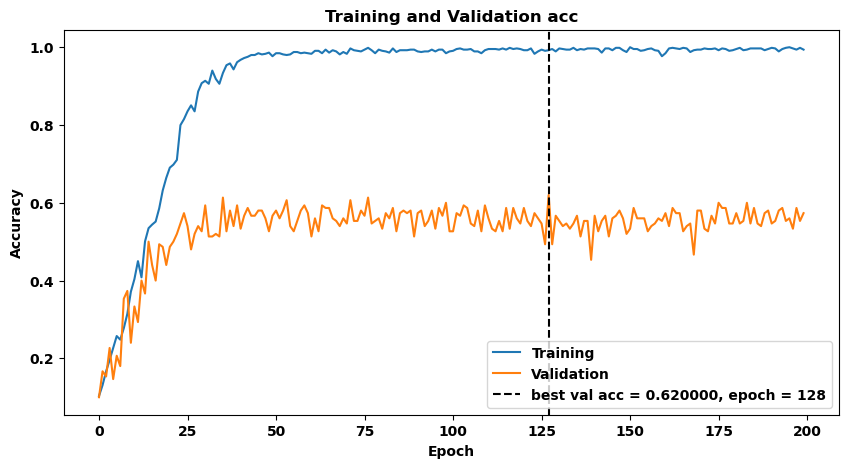

In [16]:
model_23_best_epoch, model_23_best_mse = plot_train_val_metric(model_23_history, 'acc', ylabel = 'Accuracy')

It is clear that this model has an overfit problem. Therefore, to increase the validation accuracy and decrease the overfit, it was tested adding dropout layers, kernel and bias regularization for the CNN layer, decrease the number of filters, and completely new architectures. At total, it was tested 4 different architectures using only the MEL spectrogram as input. The best result was “model 4” that uses only 16 filters, but it also reads the input three times using different CNN layers with different kernel size (further information about this model can be found in the jupyter notebook). Nonetheless, the improvement was minimal. The validation accuracy increased only to 0.6200, and it took almost 12 minutes to run 128 epochs. \
Let's try adding the pictures of the raw frequencies.

<div id='Model5' />

## Model 5

Considering that just changing the architecture was not enough to solve the overfitting, I tried a model (model 5) with 2 inputs, the MEL spectrogram and the waveform signal. Both inputs pass through 2 CNN layers with 16 filters and, after flattened, they are concatenated. Unfortunately, the overfit remained and the accuracy did not increase.

In [17]:
if flag_freq_data != 1:
    for e in music_genres:
        for i in tqdm.tqdm(range(0, 100)):
            if i < 10:
                sound, sample_rate = librosa.load(f'{music_path}{e}/{e}.0000{i}.wav')
                plt.figure(figsize = (20, 5))
                librosa.display.waveshow(y = sound, sr = sample_rate, color = "blue")
                # plt.tight_layout()
                plt.savefig(f"Data/train_freq_images/{e}/{e}.0000{i}.png")
                plt.close()
            else:
                if (e != 'jazz') | (i != 54):    # There is a problem with this music file
                    sound, sample_rate = librosa.load(f'{music_path}{e}/{e}.000{i}.wav')
                    plt.figure(figsize = (20, 5))
                    librosa.display.waveshow(y = sound, sr = sample_rate, color = "blue")
                    # plt.tight_layout()
                    if i < 65:
                        plt.tight_layout()
                        plt.savefig(f"Data/train_freq_images/{e}/{e}.000{i}.png")
                        plt.close()
                    elif i < 80:
                        plt.tight_layout()
                        plt.savefig(f"Data/val_freq_images/{e}/{e}.000{i}.png")
                        plt.close()
                    else:
                        plt.tight_layout()
                        plt.savefig(f"Data/test_freq_images/{e}/{e}.000{i}.png")
                        plt.close()

In [18]:
batch_size = 16
img_freq_height = 50 # Original size: 288
img_freq_width = 200 # Original size: 432
train_freq_images_path = "Data/train_freq_images/"
val_freq_images_path = "Data/val_freq_images/"
test_freq_images_path = "Data/test_freq_images/"
ds_freq_train = tf.keras.utils.image_dataset_from_directory(
                                                          train_freq_images_path,
                                                          # validation_split = 0.2,
                                                          # subset = "training",
                                                          seed = 1 ,
                                                          image_size = (img_freq_height, img_freq_width),
                                                          batch_size = batch_size,
                                                          shuffle = False
                                                        )
ds_freq_train_images_only = ds_freq_train.map(lambda image, label: image)

ds_freq_val = tf.keras.utils.image_dataset_from_directory(
                                                          val_freq_images_path,
                                                          # validation_split = 0.2,
                                                          # subset = "validation",
                                                          seed = 1 ,
                                                          image_size = (img_freq_height, img_freq_width),
                                                          batch_size = batch_size,
                                                          shuffle = False
                                                        )

ds_freq_test = tf.keras.utils.image_dataset_from_directory(
                                                          test_freq_images_path,
                                                          seed = 1 ,
                                                          image_size = (img_freq_height, img_freq_width),
                                                          batch_size = batch_size,
                                                          shuffle = False
                                                        )
ds_freq_test_images_only = ds_freq_test.map(lambda image, label: image)

# Extract class names
class_names = ds_freq_train.class_names

Found 649 files belonging to 10 classes.
Found 150 files belonging to 10 classes.
Found 200 files belonging to 10 classes.


In [20]:
# Get only images and labels.
ds_train_images_only = ds_train.map(lambda image, label: image)
train_labels = ds_train.map(lambda _, labels: labels)
ds_freq_train_images_only = ds_freq_train.map(lambda image, label: image)

ds_val_images_only = ds_val.map(lambda image, label: image)
val_labels = ds_val.map(lambda _, labels: labels)
ds_freq_val_images_only = ds_freq_val.map(lambda image, label: image)

ds_test_images_only = ds_test.map(lambda image, label: image)
test_labels = ds_test.map(lambda _, labels: labels)
ds_freq_test_images_only = ds_freq_test.map(lambda image, label: image)

In [21]:
# Normalize data
normalization_layer = keras.layers.Rescaling(1./255)

ds_train_images_only = ds_train_images_only.map(lambda x: (normalization_layer(x)))
ds_val_images_only = ds_val_images_only.map(lambda x: (normalization_layer(x)))
ds_test_images_only = ds_test_images_only.map(lambda x: (normalization_layer(x)))

ds_freq_train_images_only = ds_freq_train_images_only.map(lambda x: (normalization_layer(x)))
ds_freq_val_images_only = ds_freq_val_images_only.map(lambda x: (normalization_layer(x)))
ds_freq_test_images_only = ds_freq_test_images_only.map(lambda x: (normalization_layer(x)))

# Normalized dataset
for images, labels in ds_freq_train.take(1):
    print(images[0].numpy().min(), images[0].numpy().max())
    print(labels[0].numpy(), class_names[labels[0].numpy()])

0.0 255.0
0 blues


In [22]:
# check the dataset
print('Test')
for x, y in ds_freq_train.take(1):
    print("x_test shape:", x.shape)
    print("y_test shape:", y.shape)
print('---------------------------')
print('Validation')
for x, y in ds_freq_val.take(1):
    print("x_val shape:", x.shape)
    print("y_val shape:", y.shape) 
print('---------------------------')
print('Train')
for x, y in ds_freq_test.take(1):
    print("x_train shape:", x.shape)
    print("y_train shape:", y.shape) 

Test
x_test shape: (16, 50, 200, 3)
y_test shape: (16,)
---------------------------
Validation
x_val shape: (16, 50, 200, 3)
y_val shape: (16,)
---------------------------
Train
x_train shape: (16, 50, 200, 3)
y_train shape: (16,)


In [23]:
# Group datasets
combined_train_dataset = tf.data.Dataset.zip((ds_train_images_only, ds_freq_train_images_only))
combined_train_dataset = tf.data.Dataset.zip((combined_train_dataset, train_labels))
combined_val_dataset = tf.data.Dataset.zip((ds_val_images_only, ds_freq_val_images_only))
combined_val_dataset = tf.data.Dataset.zip((combined_val_dataset, val_labels))
combined_test_dataset = tf.data.Dataset.zip((ds_test_images_only, ds_freq_test_images_only))
combined_test_dataset = tf.data.Dataset.zip((combined_test_dataset, test_labels))

# Shuffle
combined_train_dataset_shuffled = combined_train_dataset.unbatch().shuffle(buffer_size = 649, seed = 1)
combined_train_dataset_shuffled = combined_train_dataset_shuffled.batch(batch_size)
combined_val_dataset_shuffled = combined_val_dataset.unbatch().shuffle(buffer_size = 150, seed = 1)
combined_val_dataset_shuffled = combined_val_dataset_shuffled.batch(batch_size)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_2 (InputLayer)           [(None, 50, 200, 3)  0           []                               
                                ]                                                                 
                                                                                                  
 Conv2D_1 (Conv2D)              (None, 150, 150, 16  448         ['input_1[0][0]']                
                                )                                                             

None

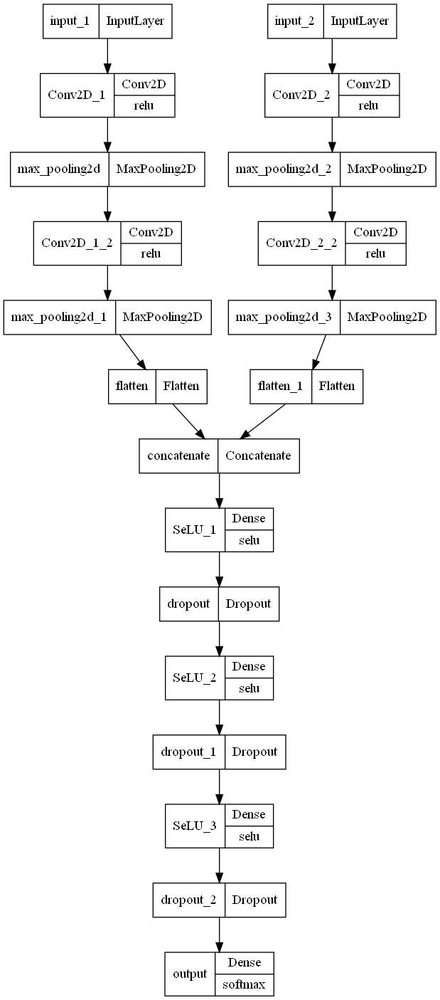

In [24]:
# model 3
tf.keras.backend.clear_session()
gc.collect()
def create_model_3(img_height, img_width, img_freq_height, img_freq_width, y_nunique):
    tf.keras.backend.clear_session()
    inputs = tf.keras.layers.Input(shape = (img_height, img_width, 3))
    inputs_freq = tf.keras.layers.Input(shape = (img_freq_height, img_freq_width, 3))
    
    x = keras.layers.Conv2D(filters = 16, kernel_size = (3, 3), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_1")(inputs)    
    x = keras.layers.MaxPooling2D(pool_size = 3, strides = 1)(x) 
    x = keras.layers.Conv2D(filters = 16, kernel_size = (3, 3), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_1_2")(x)    
    x = keras.layers.MaxPooling2D(pool_size = 3, strides = 1)(x)   
    x = keras.layers.Flatten()(x) 

    
    # Frequency images
    f = keras.layers.Conv2D(filters = 16, kernel_size = (3, 3), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_2")(inputs_freq)    
    f = keras.layers.MaxPooling2D(pool_size = 3, strides = 1)(f) 
    f = keras.layers.Conv2D(filters = 16, kernel_size = (3, 3), strides = (1, 1), padding = 'same'     
                               , activation='relu'
                               , kernel_regularizer = keras.regularizers.l2(0.01)                      
                               , bias_regularizer = keras.regularizers.l2(0.01)                       
                               , name = "Conv2D_2_2")(f)    
    f = keras.layers.MaxPooling2D(pool_size = 3, strides = 1)(f)   
    f = keras.layers.Flatten()(f)

    concat_x_f = keras.layers.Concatenate()([x, f])
    
    x = keras.layers.Dense(128, activation = 'selu', name = "SeLU_1")(concat_x_f)
    x = keras.layers.Dropout(0.10)(x)               # 0.10 = 0.6979 
    x = keras.layers.Dense(32, activation='selu', name = "SeLU_2")(x)
    x = keras.layers.Dropout(0.10)(x)               # 0.6479
    x = keras.layers.Dense(16, activation='selu', name = "SeLU_3")(x)
    x = keras.layers.Dropout(0.10)(x)               # 0.15 = 0.647; 0.10 = 0.6979; # 0.05 = 0.660
    
    outputs = keras.layers.Dense(units = y_nunique, activation = 'softmax', name = 'output')(x)
    
    model = keras.models.Model(inputs = (inputs, inputs_freq), outputs = outputs)
    model.compile(loss = 'sparse_categorical_crossentropy',
                  optimizer = keras.optimizers.Adam(learning_rate = 0.00001),
                  metrics = ['acc'],
                 )

    return model

model_3 = create_model_3(img_height, img_width, img_freq_height, img_freq_width, y_nunique = len(class_names))
display(model_3.summary())
print()
keras.utils.plot_model(model_3, show_layer_activations=True)

In [25]:
# Train model 
start = time.time()
epochs = 200

model_3_history = model_3.fit(combined_train_dataset
                                , validation_data = combined_val_dataset
                                # , batch_size = 32
                                , epochs = epochs
                                , verbose = 1
                                , workers = -1
                                , use_multiprocessing = True)
end = time.time()
end_time = (end - start)
print(f'Run time in minutes: {end_time/60:.2f}')

Epoch 1/200
41/41 [==============================] - 7s 123ms/step - loss: 5.8463 - acc: 0.0986 - val_loss: 3.5316 - val_acc: 0.1000
Epoch 2/200
41/41 [==============================] - 5s 110ms/step - loss: 3.9102 - acc: 0.0478 - val_loss: 3.0387 - val_acc: 0.1000
Epoch 3/200
41/41 [==============================] - 5s 109ms/step - loss: 3.7059 - acc: 0.1140 - val_loss: 3.0638 - val_acc: 0.1400
Epoch 4/200
41/41 [==============================] - 5s 107ms/step - loss: 3.4811 - acc: 0.0832 - val_loss: 2.8647 - val_acc: 0.1333
Epoch 5/200
41/41 [==============================] - 5s 107ms/step - loss: 3.5099 - acc: 0.0909 - val_loss: 2.9471 - val_acc: 0.1000
Epoch 6/200
41/41 [==============================] - 5s 106ms/step - loss: 3.6620 - acc: 0.0755 - val_loss: 2.9113 - val_acc: 0.1000
Epoch 7/200
41/41 [==============================] - 5s 106ms/step - loss: 3.3054 - acc: 0.1140 - val_loss: 2.9000 - val_acc: 0.1133
Epoch 8/200
41/41 [==============================] - 5s 105ms/step - 

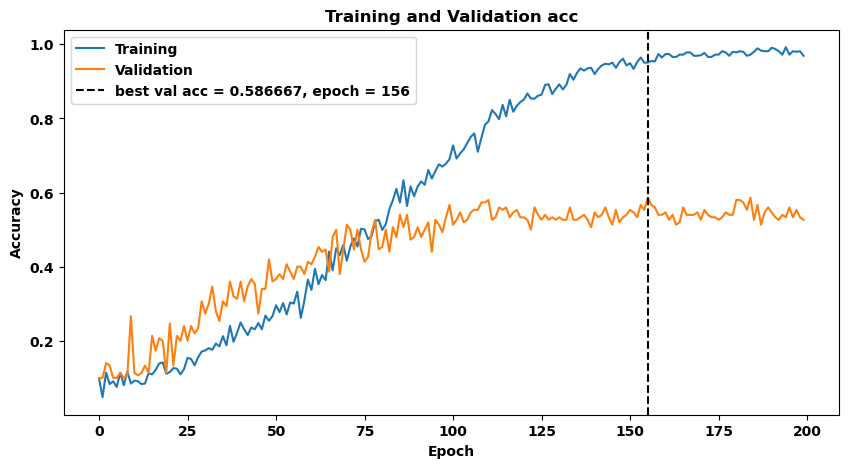

In [26]:
model_3_best_epoch, model_3_best_mse = plot_train_val_metric(model_3_history, 'acc', ylabel = 'Accuracy')

One possible reason for none of these approaches solve the overfitting problem is the lack of data. Hence, I tried using transfer learning with pre-trained weights and adding some new dense layers to fine tune the model. The models that I tried are Resnet50 and EfficientNetB2. The model with the best performance was EfficientNetB2 with a validation accuracy of 0.6533 and a training accuracy of 0.8259. It took more than 20 minutes to run.

<div id='TransferLearning' />

## Transfer Learning

<div id='Resnet50' />

## Resnet50

### Load data

First, I will load the data in a format accepted by Resnet50

In [32]:
batch_size = 32
img_height = 224 # Original size: 288
img_width = 224 # Original size: 432
train_images_path = "Data/train_images/"
val_images_path = "Data/val_images/"
test_images_path = "Data/test_images/"

ds_train = tf.keras.utils.image_dataset_from_directory(
                                                          train_images_path,
                                                          # validation_split = 0.2,
                                                          # subset = "training",
                                                          seed = 1,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = True
                                                        )

ds_val = tf.keras.utils.image_dataset_from_directory(
                                                          val_images_path,
                                                          # validation_split = 0.2,
                                                          # subset = "validation",
                                                          seed = 1 ,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = True
                                                        )



ds_test = tf.keras.utils.image_dataset_from_directory(
                                                          test_images_path,
                                                          seed = 1 ,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = True
                                                        )

# Extract class names
class_names = ds_test.class_names

Found 649 files belonging to 10 classes.
Found 150 files belonging to 10 classes.
Found 200 files belonging to 10 classes.


In [34]:
# check the dataset
print('Train')
for x, y in ds_train.take(1):
    print("x_test shape:", x.shape)
    print("y_test shape:", y.shape)
print('---------------------------')
print('Validation')
for x, y in ds_val.take(1):
    print("x_val shape:", x.shape)
    print("y_val shape:", y.shape) 
print('---------------------------')
print('Test')
for x, y in ds_test.take(1):
    print("x_train shape:", x.shape)
    print("y_train shape:", y.shape) 

Train
x_test shape: (32, 224, 224, 3)
y_test shape: (32,)
---------------------------
Validation
x_val shape: (32, 224, 224, 3)
y_val shape: (32,)
---------------------------
Test
x_train shape: (32, 224, 224, 3)
y_train shape: (32,)


### Model Resnet50

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

None

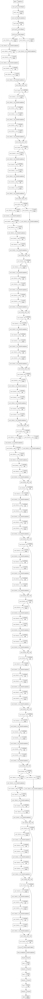

In [35]:
tf.keras.backend.clear_session()
def create_model_resnet(img_height = 260, img_width = 260, y_nunique = len(class_names)):
    tf.keras.backend.clear_session()
    inputs = keras.layers.Input(shape = (img_height, img_width, 3))

    # EfficientNetB2 (https://keras.io/examples/vision/image_classification_efficientnet_fine_tuning/)
    model_ResNet50 = tf.keras.applications.resnet50.ResNet50(include_top = False, input_tensor = inputs, weights = "imagenet")
    # Freeze the pretrained weights
    model_ResNet50.trainable = False
    # Rebuild top
    x = keras.layers.GlobalAveragePooling2D(name="avg_pool")(model_ResNet50.output)
    x = keras.layers.BatchNormalization()(x)

    x = keras.layers.Dropout(0.10)(x)
    x = keras.layers.Dense(128, activation = 'selu', name = "SeLU_1")(x)
    x = keras.layers.Dropout(0.10)(x)               
    x = keras.layers.Dense(32, activation='selu', name = "SeLU_2")(x)
    x = keras.layers.Dropout(0.10)(x)                
    x = keras.layers.Dense(16, activation='selu', name = "SeLU_3")(x)
    x = keras.layers.Dropout(0.10)(x)               
    outputs = keras.layers.Dense(units = y_nunique, activation = 'softmax', name = 'output')(x)
    
    model = keras.models.Model(inputs = inputs, outputs = outputs)
    model.layers[1].trainable = False   # I will not train the weights from the base model.
    model.compile(loss = 'sparse_categorical_crossentropy',
                  optimizer = keras.optimizers.Adam(learning_rate = 0.0001),
                  metrics = ['acc'],
                 )


    return model

model_resnet = create_model_resnet(img_height = 224, img_width = 224, y_nunique = len(class_names))
display(model_resnet.summary())
print()
keras.utils.plot_model(model_resnet, show_layer_activations=True)

In [36]:
# Train model 
start = time.time()
epochs = 500

model_resnet_history = model_resnet.fit(ds_train
                                , validation_data = ds_val
                                # , batch_size = 32
                                , epochs = epochs
                                , verbose = 1
                                , workers = -1
                                , use_multiprocessing = True)
end = time.time()
end_time = (end - start)
print(f'Run time in minutes: {end_time/60:.2f}')

Epoch 1/500
21/21 [==============================] - 10s 244ms/step - loss: 2.8908 - acc: 0.1541 - val_loss: 2.8626 - val_acc: 0.1067
Epoch 2/500
21/21 [==============================] - 4s 149ms/step - loss: 2.0958 - acc: 0.3267 - val_loss: 2.3997 - val_acc: 0.1133
Epoch 3/500
21/21 [==============================] - 4s 148ms/step - loss: 1.7318 - acc: 0.4176 - val_loss: 2.0980 - val_acc: 0.2067
Epoch 4/500
21/21 [==============================] - 4s 148ms/step - loss: 1.6277 - acc: 0.4576 - val_loss: 1.9007 - val_acc: 0.3067
Epoch 5/500
21/21 [==============================] - 4s 146ms/step - loss: 1.4819 - acc: 0.4915 - val_loss: 1.7868 - val_acc: 0.3933
Epoch 6/500
21/21 [==============================] - 4s 148ms/step - loss: 1.3110 - acc: 0.5670 - val_loss: 1.6943 - val_acc: 0.4333
Epoch 7/500
21/21 [==============================] - 4s 150ms/step - loss: 1.2450 - acc: 0.5963 - val_loss: 1.5937 - val_acc: 0.4400
Epoch 8/500
21/21 [==============================] - 4s 149ms/step -

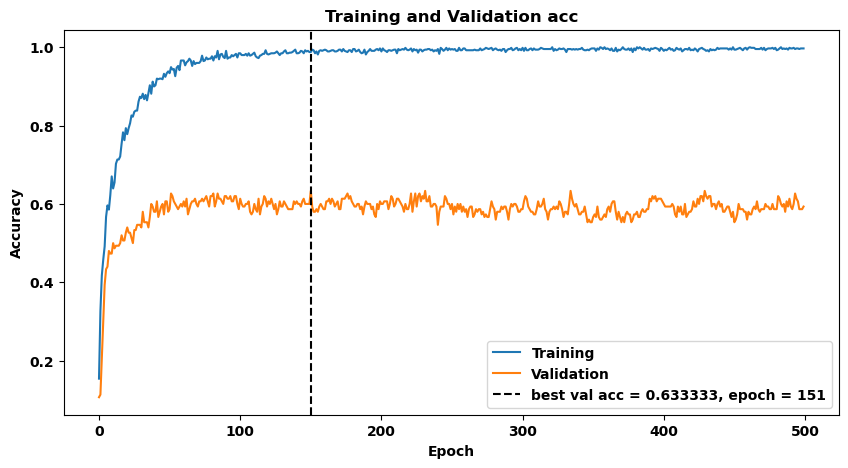

In [37]:
model_resnet_history_best_epoch, model_resnet_history_best_mse = plot_train_val_metric(model_resnet_history, 'acc', ylabel = 'Accuracy')

<div id='EfficientNetB2' />

## EfficientNetB2

P.S.: EfficientNet models expect their inputs to be float tensors of pixels with values in the [0-255] range. (https://www.tensorflow.org/api_docs/python/tf/keras/applications/efficientnet/EfficientNetB2)

For B0 to B7 base models, the input shapes are different. Here is a list of input shape expected for each model:
|Base model|	resolution|
|-----------|------------|
|EfficientNetB0|	224|
|EfficientNetB1|	240|
|EfficientNetB2|	260|
|EfficientNetB3|	300|
|EfficientNetB4|	380|
|EfficientNetB5|	456|
|EfficientNetB6|	528|
|EfficientNetB7|	600|

### Load Data

In [38]:
batch_size = 32
img_height = 260 # Original size: 288
img_width = 260 # Original size: 432
train_images_path = "Data/train_images/"
val_images_path = "Data/val_images/"
test_images_path = "Data/test_images/"

ds_train = tf.keras.utils.image_dataset_from_directory(
                                                          train_images_path,
                                                          # validation_split = 0.2,
                                                          # subset = "training",
                                                          seed = 1 ,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = True
                                                        )

ds_val = tf.keras.utils.image_dataset_from_directory(
                                                          val_images_path,
                                                          # validation_split = 0.2,
                                                          # subset = "validation",
                                                          seed = 1 ,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = True
                                                        )



ds_test = tf.keras.utils.image_dataset_from_directory(
                                                          test_images_path,
                                                          seed = 1 ,
                                                          image_size = (img_height, img_width),
                                                          batch_size = batch_size,
                                                          shuffle = False
                                                        )

# Extract class names
class_names = ds_test.class_names

Found 649 files belonging to 10 classes.
Found 150 files belonging to 10 classes.
Found 200 files belonging to 10 classes.


In [40]:
# check the dataset
print('Train')
for x, y in ds_train.take(1):
    print("x_test shape:", x.shape)
    print("y_test shape:", y.shape)
print('---------------------------')
print('Validation')
for x, y in ds_val.take(1):
    print("x_val shape:", x.shape)
    print("y_val shape:", y.shape) 
print('---------------------------')
print('Test')
for x, y in ds_test.take(1):
    print("x_train shape:", x.shape)
    print("y_train shape:", y.shape) 

Train
x_test shape: (32, 260, 260, 3)
y_test shape: (32,)
---------------------------
Validation
x_val shape: (32, 260, 260, 3)
y_val shape: (32,)
---------------------------
Test
x_train shape: (32, 260, 260, 3)
y_train shape: (32,)


### Model EfficientNetB2

Model: "EfficientNet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 260, 260, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 260, 260, 3)  0           ['input_1[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 260, 260, 3)  7           ['rescaling[0][0]']              
                                                                                                  
 rescaling_1 (Rescaling)        (None, 260, 260, 3)  0           ['normalization[0][0]'

None

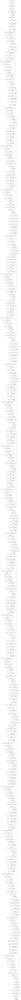

In [41]:
tf.keras.backend.clear_session()
def create_model_EfficientNetB2(img_height = 260, img_width = 260, y_nunique = len(class_names)):
    tf.keras.backend.clear_session()
    inputs = keras.layers.Input(shape = (img_height, img_width, 3))

    # EfficientNetB2 (https://keras.io/examples/vision/image_classification_efficientnet_fine_tuning/)
    model_EfficientNetB2 = tf.keras.applications.efficientnet.EfficientNetB2(include_top = False, input_tensor = inputs, weights = "imagenet")
    # Freeze the pretrained weights
    model_EfficientNetB2.trainable = False
    # Rebuild top
    x = keras.layers.GlobalAveragePooling2D(name="avg_pool")(model_EfficientNetB2.output)
    x = keras.layers.BatchNormalization()(x)

    top_dropout_rate = 0.2
    x = keras.layers.Dropout(top_dropout_rate, name="top_dropout")(x)
    outputs = keras.layers.Dense(y_nunique, activation="softmax", name="pred")(x)

    # Compile
    model = keras.Model(inputs, outputs, name="EfficientNet")
    optimizer = keras.optimizers.Adam(learning_rate = 0.0001)
    model.compile(
        optimizer = optimizer, loss = "sparse_categorical_crossentropy", metrics=["acc"]
    )

    return model

model_EfficientNetB2 = create_model_EfficientNetB2(img_height = 260, img_width = 260, y_nunique = len(class_names))
display(model_EfficientNetB2.summary())
print()
keras.utils.plot_model(model_EfficientNetB2, show_layer_activations=True)

In [42]:
# Train model 
start = time.time()
epochs = 300

model_EfficientNetB2_history = model_EfficientNetB2.fit(ds_train
                                                        , validation_data = ds_val
                                                        # , batch_size = 32
                                                        , epochs = epochs
                                                        , verbose = 1
                                                        , workers = -1
                                                        , use_multiprocessing = True)
end = time.time()
end_time = (end - start)
print(f'Run time in minutes: {end_time/60:.2f}')

Epoch 1/300
21/21 [==============================] - 19s 374ms/step - loss: 3.2160 - acc: 0.0832 - val_loss: 2.3758 - val_acc: 0.0933
Epoch 2/300
21/21 [==============================] - 4s 192ms/step - loss: 2.7750 - acc: 0.1310 - val_loss: 2.3057 - val_acc: 0.1067
Epoch 3/300
21/21 [==============================] - 4s 188ms/step - loss: 2.4938 - acc: 0.1741 - val_loss: 2.2474 - val_acc: 0.1533
Epoch 4/300
21/21 [==============================] - 4s 190ms/step - loss: 2.2551 - acc: 0.2404 - val_loss: 2.1969 - val_acc: 0.2133
Epoch 5/300
21/21 [==============================] - 4s 191ms/step - loss: 2.1380 - acc: 0.2712 - val_loss: 2.1508 - val_acc: 0.2267
Epoch 6/300
21/21 [==============================] - 5s 193ms/step - loss: 2.0728 - acc: 0.3066 - val_loss: 2.1048 - val_acc: 0.2600
Epoch 7/300
21/21 [==============================] - 5s 195ms/step - loss: 1.9695 - acc: 0.3128 - val_loss: 2.0608 - val_acc: 0.3000
Epoch 8/300
21/21 [==============================] - 4s 192ms/step -

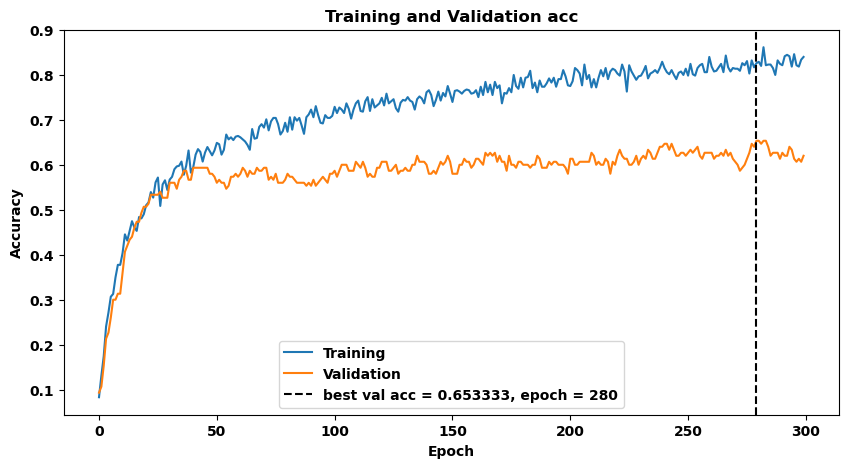

In [43]:
model_EfficientNetB2_history_best_epoch, model_EfficientNetB2_history_best_mse = plot_train_val_metric(model_EfficientNetB2_history, 'acc', ylabel = 'Accuracy')

<div id='ModelPerformanceTranferLearning' />

### Model Performance

In [44]:
# Evaluate on test
all_y_true = tf.concat([y_true for _, y_true in ds_test], axis=0).numpy()
y_pred_aux = model_EfficientNetB2.predict(ds_test)
y_pred = []
for i in range(len(y_pred_aux)):
    y_pred.append(np.argmax(y_pred_aux[i]))

accuracy_test = accuracy_score(all_y_true, y_pred)
print(f'Test accuracy: {accuracy_test}')

7/7 [==============================] - 4s 276ms/step
Test accuracy: 0.62


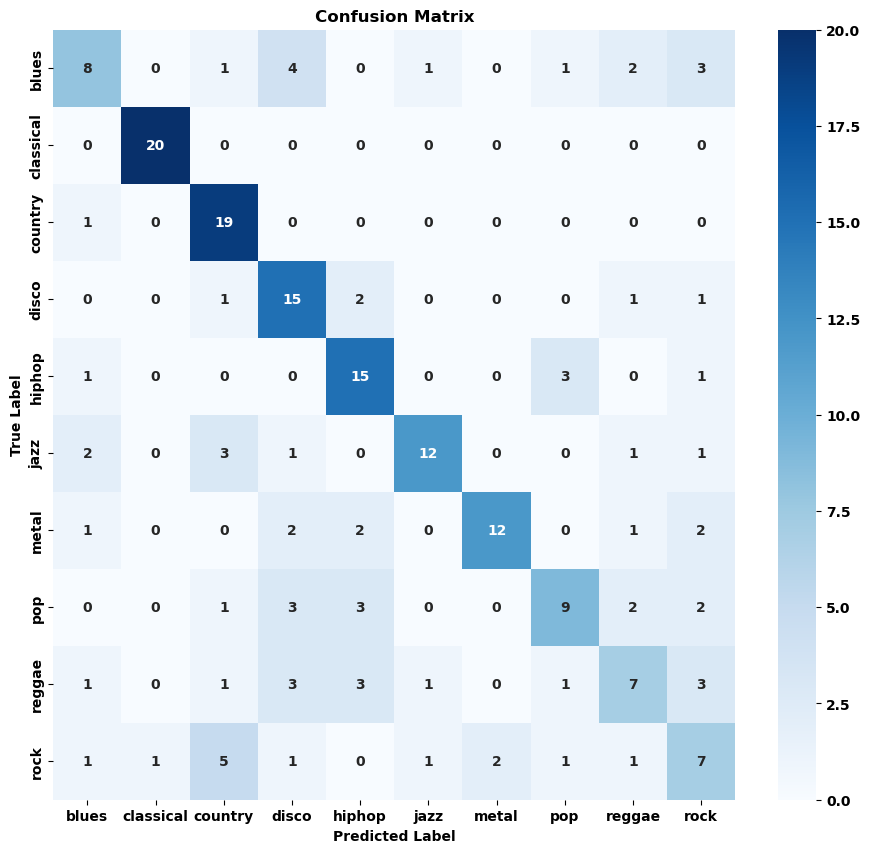

In [45]:
# Compute confusion matrix
cm = confusion_matrix(all_y_true, y_pred, labels=np.arange(len(class_names)))

# Plot the confusion matrix with class labels using seaborn
fig, ax = plt.subplots(figsize=(len(class_names) + 1, len(class_names)))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

<div id='Conclusion' />

## Conclusion

As we can see, the model was capable of perfectly identify the classical genre. In addition, only one music from the genre country was mislabeled. Moreover, the genre disco and hiphop had a satisfactory accuracy of 75%, and the genres jazz and metal had an accuracy higher than 50%. On the other hand, the model struggled in accurately classifying the blues, pop, reggae, and rock genres, with accuracies ranging from 35% to 45%. \
It is interesting to notice that this model mixed some blues songs as disco, and some rock songs as country. No prevalent genre mixing was observed for pop and reggae.
